In [59]:
#!/usr/bin/env python3
import pathlib
from datetime import datetime, timedelta
import httpx
import spacetrack.operators as op
from spacetrack import SpaceTrackClient

# email = "zcesccc@ucl.ac.uk"
# password = "sj1GXDhz1PpcK4iEAZSaWr"

# start = datetime(2024, 5, 8)
# end = datetime(2024, 5, 15)

# st = SpaceTrackClient(identity=email, password=password, httpx_client=httpx.Client(timeout=httpx.Timeout(60)))

# outdir = pathlib.Path("tle_archive")
# outdir.mkdir(exist_ok=True)
# outfile = outdir / f"tle_data_{start.date()}_to_{end.date()}.tle"
# if outfile.exists():
#     outfile.unlink()

# current = start
# with open(outfile, "w") as fp:
#     while current <= end:
#         next_day = current + timedelta(days=1)
#         drange = op.inclusive_range(current, next_day)
#         for line in st.tle_publish(iter_lines=True, publish_epoch=drange, format="tle"):
#             fp.write(line + "\n")
#         current = next_day

# st.close()
# print(outfile)

In [60]:
#!/usr/bin/env python3
"""
Create two dictionaries:
• `all_tle_dict`   – every TLE read from the cached file (no filters)
• `filtered_tle_dict` – same set but
    · Starlink / OneWeb removed
    · epochs limited to 1–30 May 2024
    · eccentricity ≤ 0.01
    · semi-major-axis must not increase from 10 May to 13 May 2024
"""
from datetime import datetime, timedelta, timezone
from collections import defaultdict
import math, csv, pathlib

mu = 398600.4418
M, A, Cd = 1.0, 1.0, 2.2

path = pathlib.Path("/Users/charlesc/Documents/GitHub/POD-Density-Inversion/source/tools/tle_archive/tle_data_2024-05-08_to_2024-05-15.tle")
satcat_path = pathlib.Path("/Users/charlesc/Documents/GitHub/POD-Density-Inversion/source/tools/tle_archive/celestrak_satcat.csv")

def mm(line2):
    return float(line2[52:63])

def mm_dot(line1):
    return float(line1[33:43])

def epoch(line1):
    e = line1[18:32]
    return (
        datetime(2000 + int(e[:2]), 1, 1) + timedelta(days=float(e[2:]) - 1)
    ).replace(tzinfo=timezone.utc)

all_tle_dict = defaultdict(list)
with open(path) as f:
    lines = [ln.rstrip() for ln in f if ln.strip()]

for i in range(0, len(lines), 2):
    l1, l2 = lines[i], lines[i + 1]
    sat = l1[2:7]
    t = epoch(l1)
    N = mm(l2)
    Ndot = mm_dot(l1)
    n = N * 2 * math.pi / 86400
    ndot = Ndot * 2 * math.pi / 86400 ** 2
    a = (mu / n ** 2) ** (1 / 3)
    ecc = float("0." + l2[26:33])
    v = math.sqrt(mu / a)
    rho = (2 * M * ndot) / (3 * Cd * A * n * v)
    all_tle_dict[sat].append((t, n, ndot, a, ecc, v, rho))

print(f"Loaded TLEs for {len(all_tle_dict)} unique NORAD IDs (unfiltered)")

names = {}
with satcat_path.open() as f:
    for row in csv.DictReader(f):
        names[row["NORAD_CAT_ID"].lstrip("0")] = row["OBJECT_NAME"].upper()

start_date   = datetime(2024, 5, 8,  tzinfo=timezone.utc).date()
period_start = datetime(2024, 5, 10, tzinfo=timezone.utc).date()
period_end   = datetime(2024, 5, 13, tzinfo=timezone.utc).date()
end_date     = datetime(2024, 5, 15, tzinfo=timezone.utc).date()
block        = ("STARLINK", "ONEWEB")

filtered_tle_dict = {}
for sat, recs in all_tle_dict.items():
    if any(b in names.get(sat, "") for b in block):
        continue
    in_range = [r for r in recs if start_date <= r[0].date() <= end_date and r[4] <= 0.01]
    if not in_range:
        continue
    period_recs = [r for r in in_range if period_start <= r[0].date() <= period_end]
    if len(period_recs) >= 2:
        period_recs.sort(key=lambda r: r[0])
        if period_recs[-1][3] - period_recs[0][3] > 0:
            continue
    filtered_tle_dict[sat] = in_range

print(f"After all filters: {len(filtered_tle_dict)} unique NORAD IDs")

Loaded TLEs for 27589 unique NORAD IDs (unfiltered)
After all filters: 12613 unique NORAD IDs


Unique objects after all filters: 12613


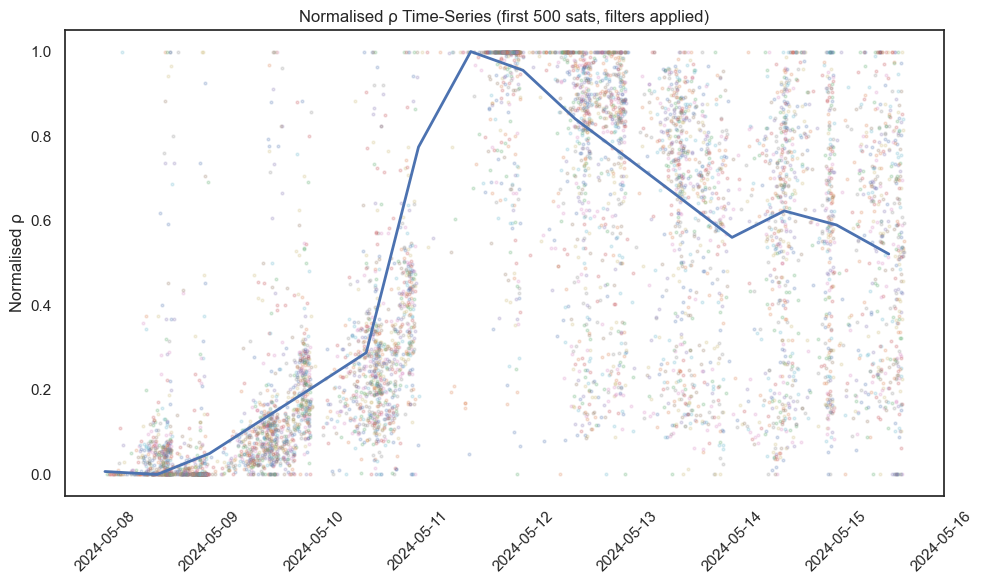

In [61]:
from collections import defaultdict
from datetime import datetime
import numpy as np
import matplotlib.pyplot as plt

# `filtered_tle_dict` already:
#   • excludes Starlink / OneWeb
#   • is limited to 8–15 May 2024
#   • contains only records with ecc ≤ 0.01
print(f"Unique objects after all filters: {len(filtered_tle_dict)}")

# pick up to 500 satellites for the plot
subset = list(filtered_tle_dict)[:500]

all_times, all_norm = [], []
plt.figure(figsize=(10, 6))

for sat in subset:
    recs = sorted(filtered_tle_dict[sat], key=lambda r: r[0])
    times = [r[0] for r in recs]
    rhos = [r[6] for r in recs]

    rmin, rmax = min(rhos), max(rhos)
    if rmax == rmin:                       # flat series → all zeros
        norm = [0] * len(rhos)
    else:
        norm = [(r - rmin) / (rmax - rmin) for r in rhos]

    plt.scatter(times, norm, s=4, alpha=0.2)
    all_times.extend(times)
    all_norm.extend(norm)

# median every 12 h (2 × 6 h bins)
bin_seconds = 21_600 * 2
bins = defaultdict(list)
for t, v in zip(all_times, all_norm):
    key = int(t.timestamp() // bin_seconds) * bin_seconds
    bins[key].append(v)

med_t = sorted(bins)
med_v = [np.median(bins[k]) for k in med_t]

plt.plot([datetime.utcfromtimestamp(k) for k in med_t], med_v, lw=2)

plt.xticks(rotation=45)
plt.ylabel("Normalised ρ")
plt.title("Normalised ρ Time-Series (first 500 sats, filters applied)")
plt.tight_layout()
plt.show()

300-400 km band → 195 objects


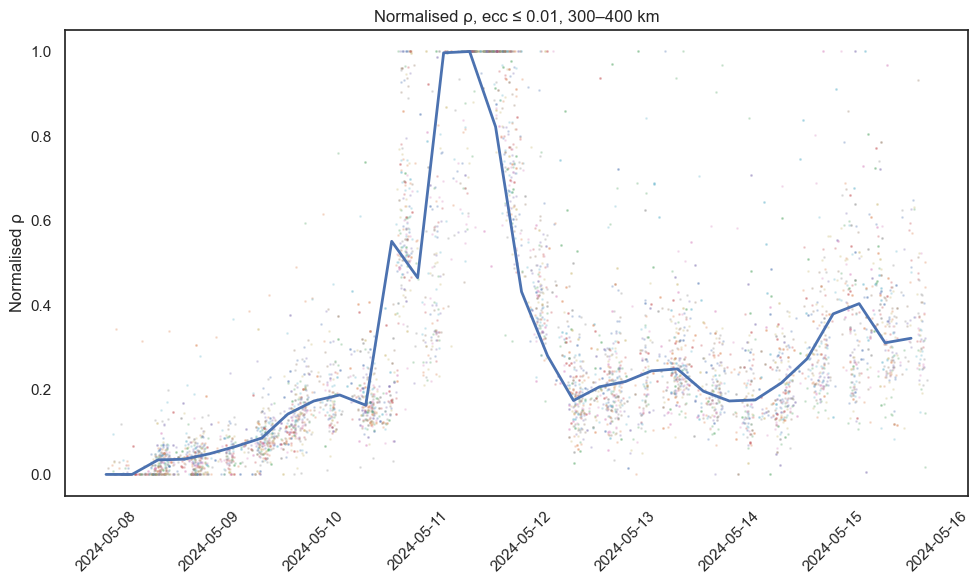

400-500 km band → 500 objects


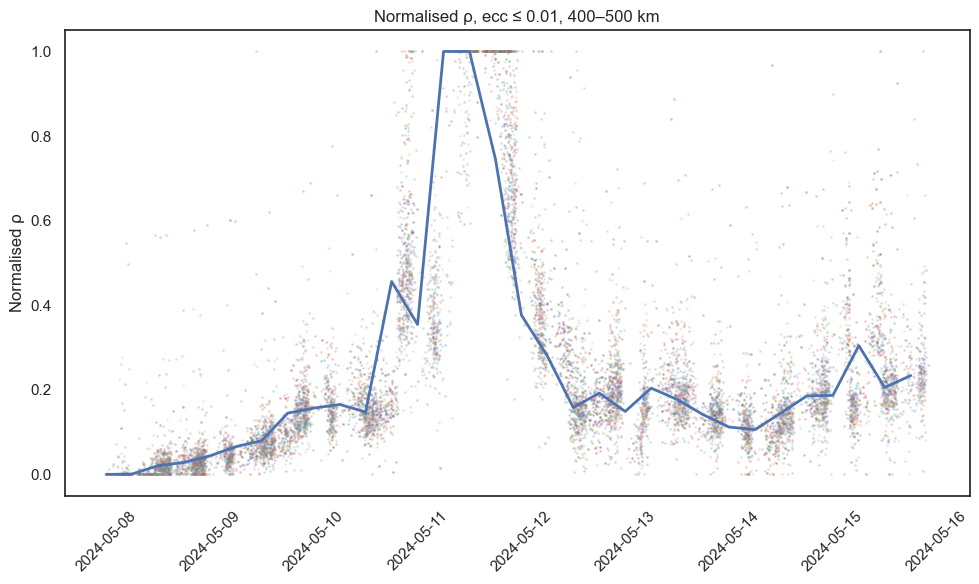

500-600 km band → 500 objects


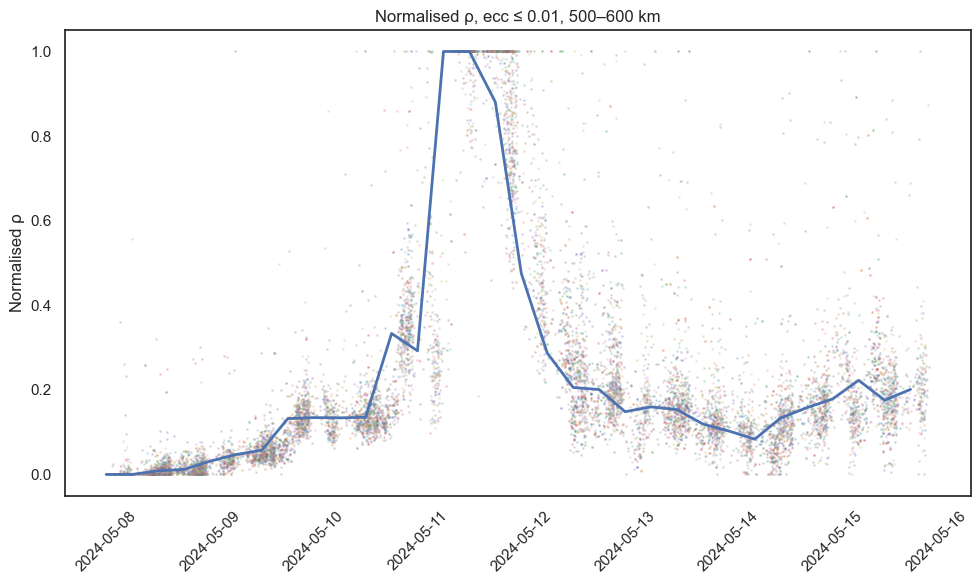

600-700 km band → 500 objects


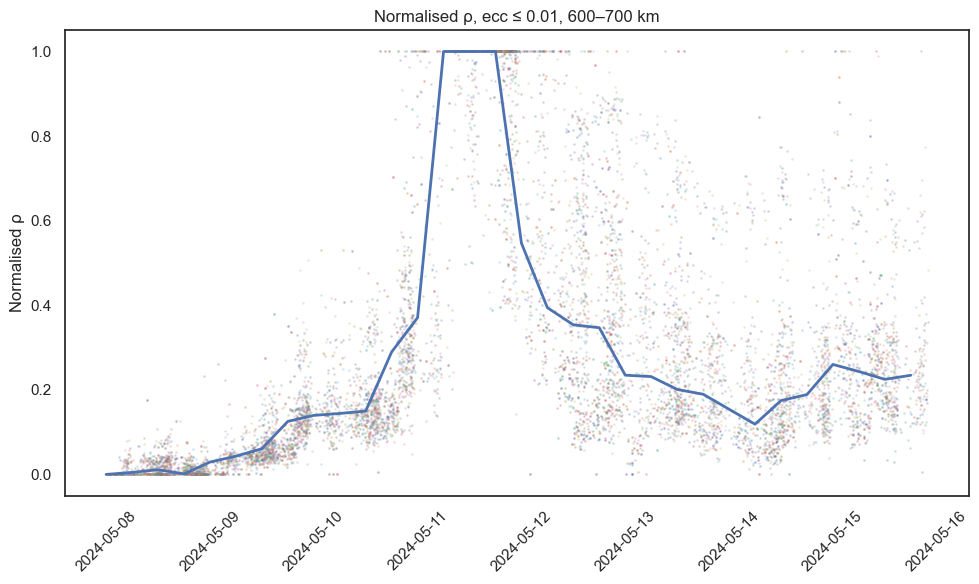

700-800 km band → 500 objects


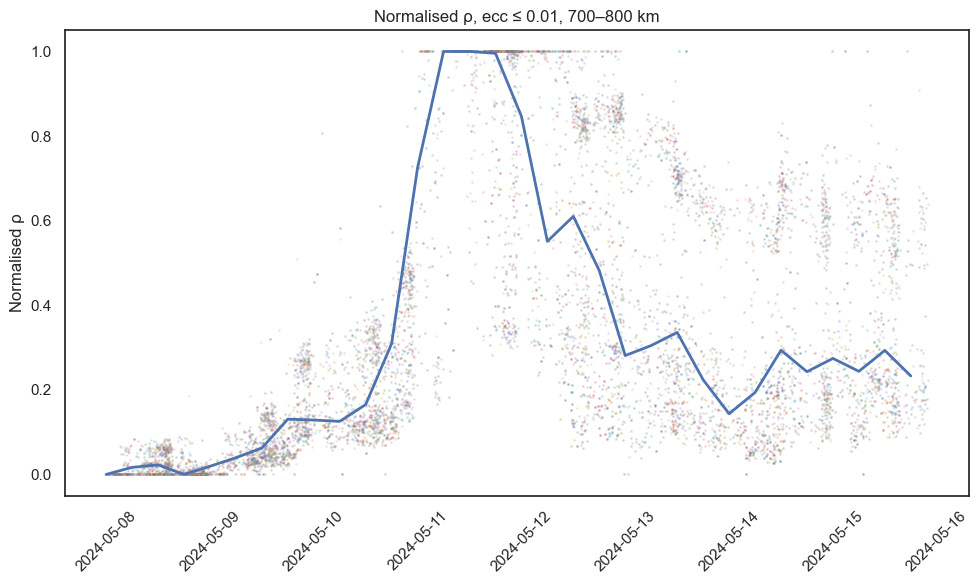

800-900 km band → 500 objects


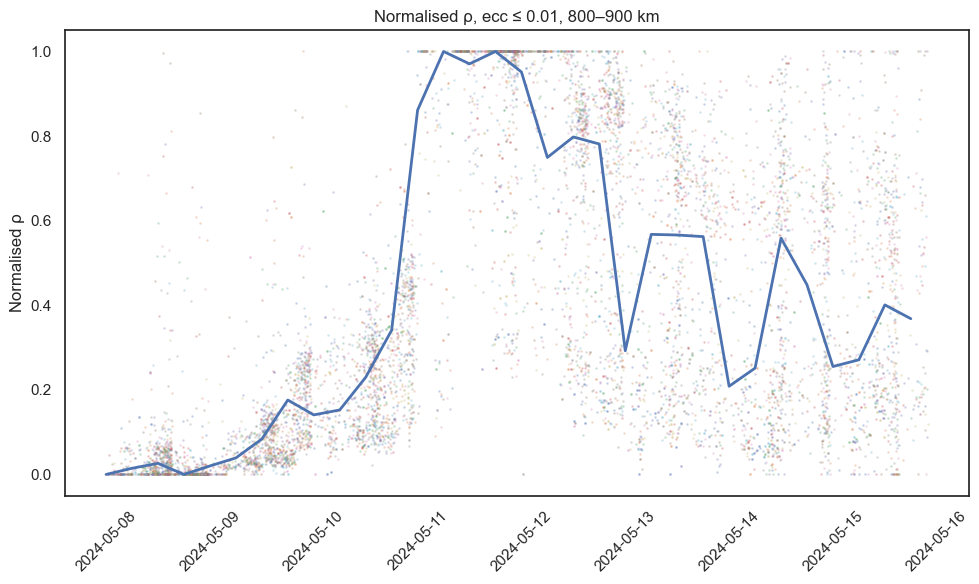

900-1000 km band → 500 objects


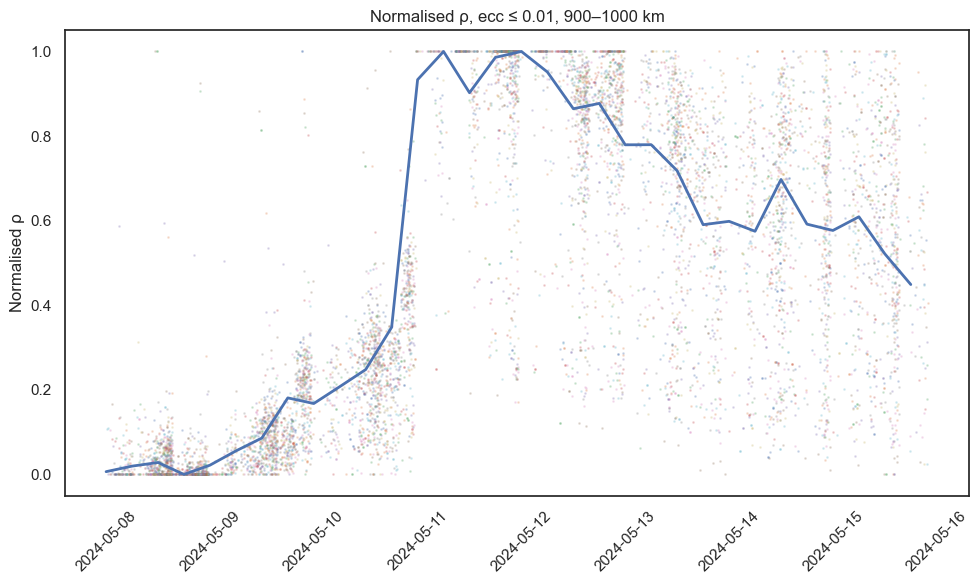

1000-1100 km band → 378 objects


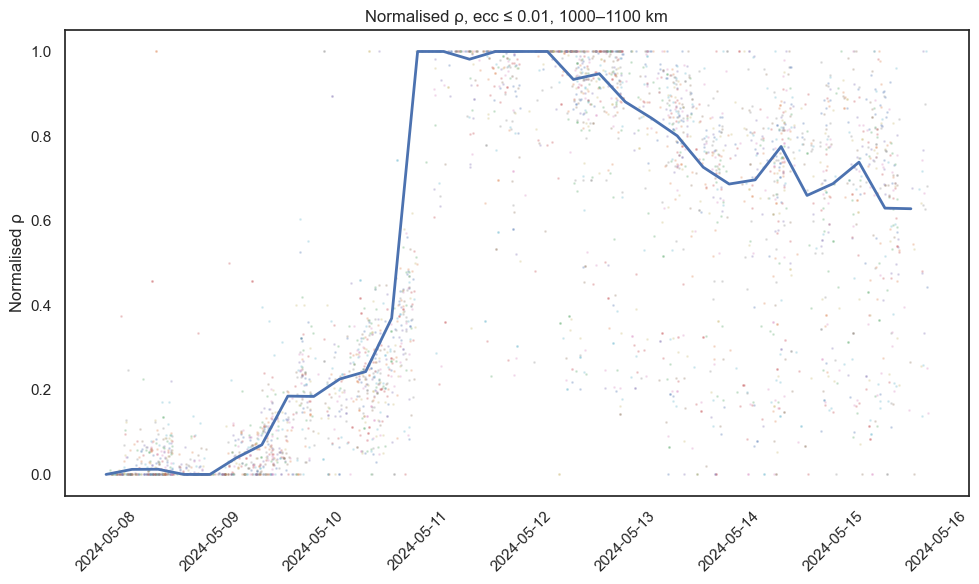

1100-1200 km band → 212 objects


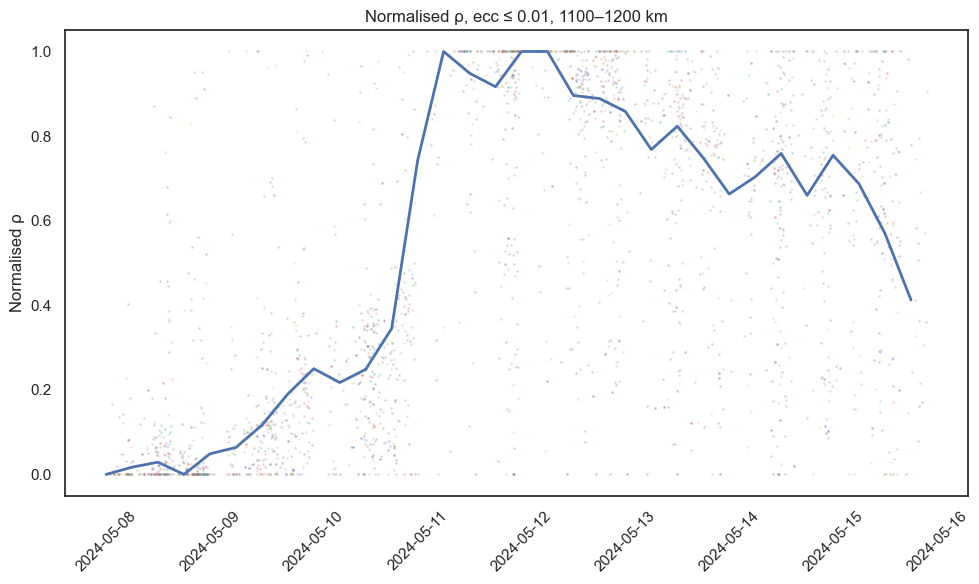

1200-1300 km band → 178 objects


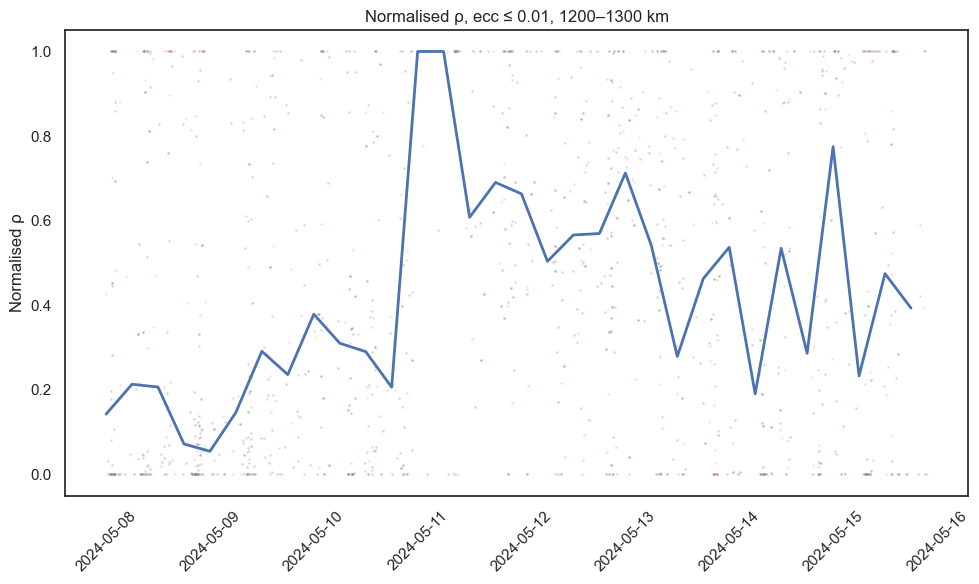

1300-1400 km band → 126 objects


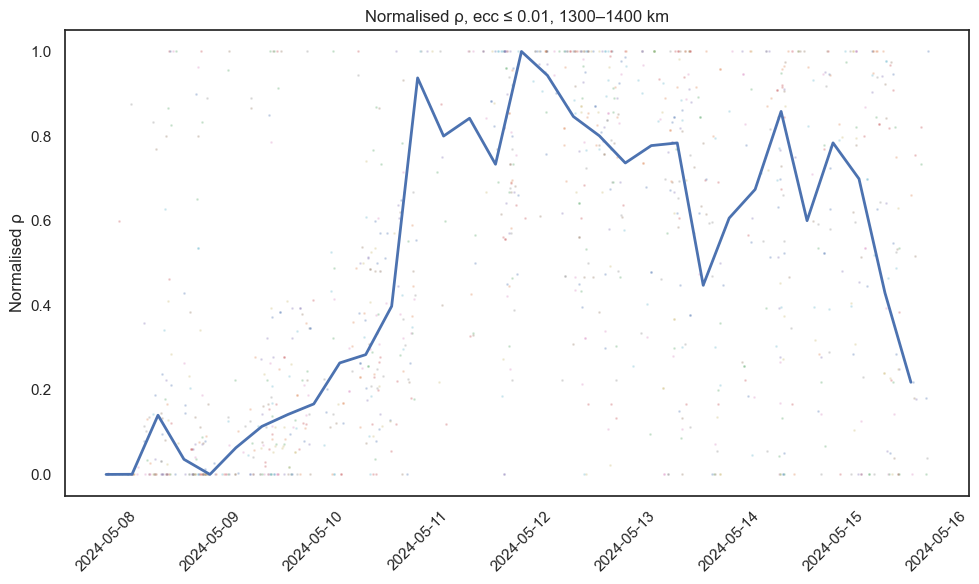

1400-1500 km band → 500 objects


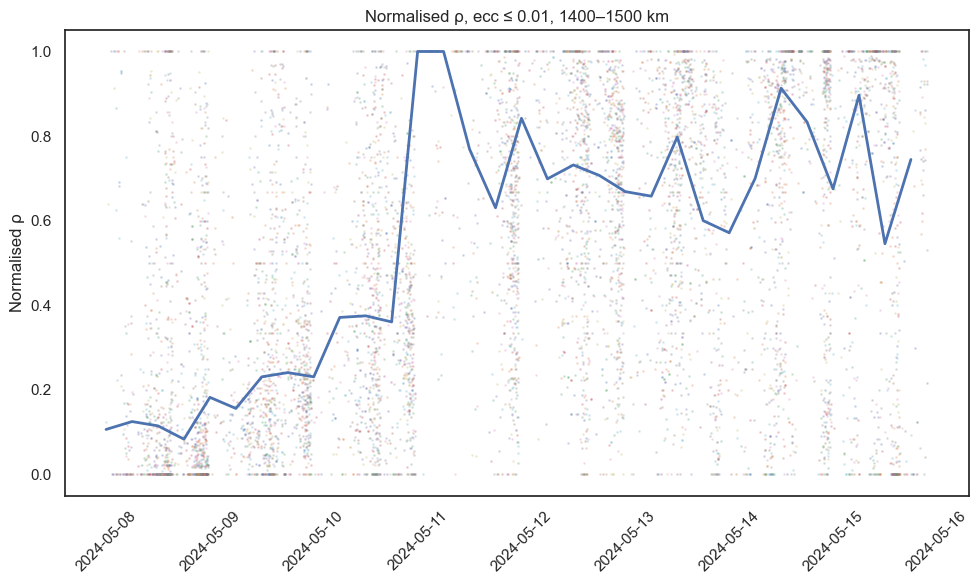

1500-1600 km band → 273 objects


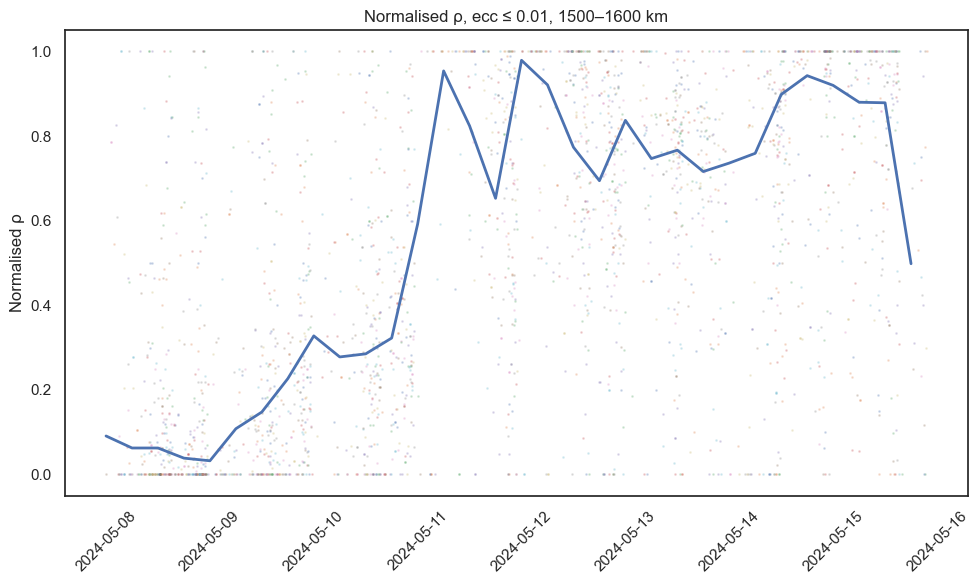

1600-1700 km band → 35 objects


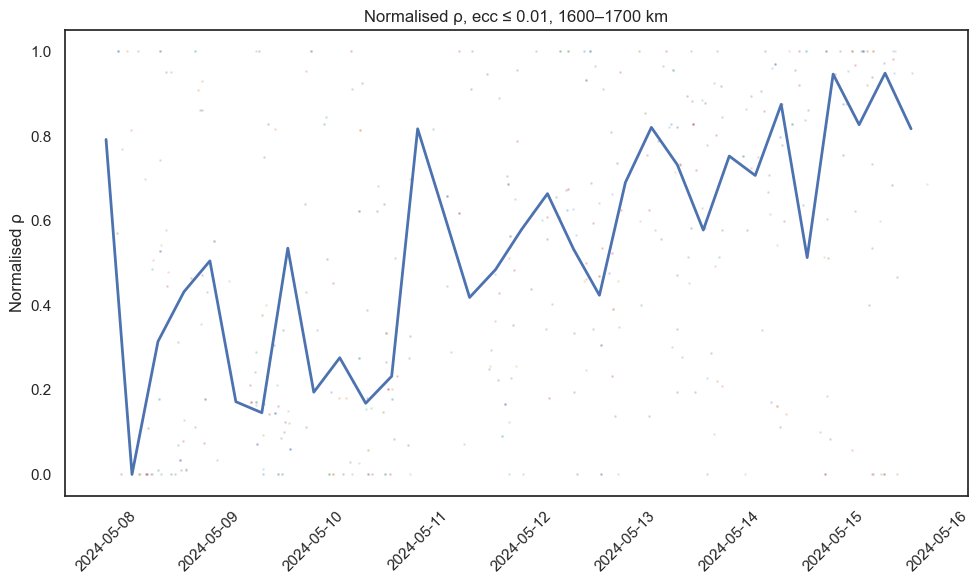

1700-1800 km band → 9 objects


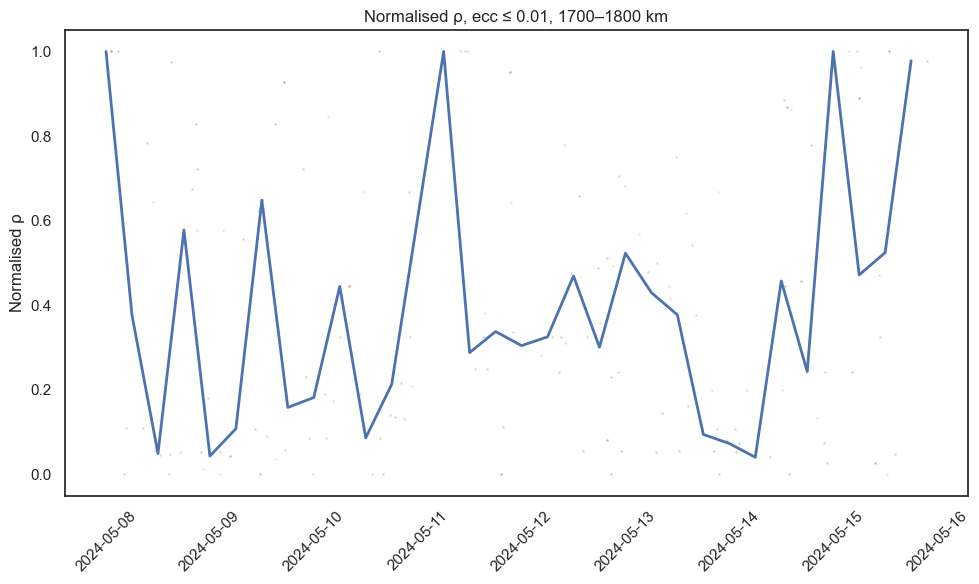

1800-1900 km band → 4 objects


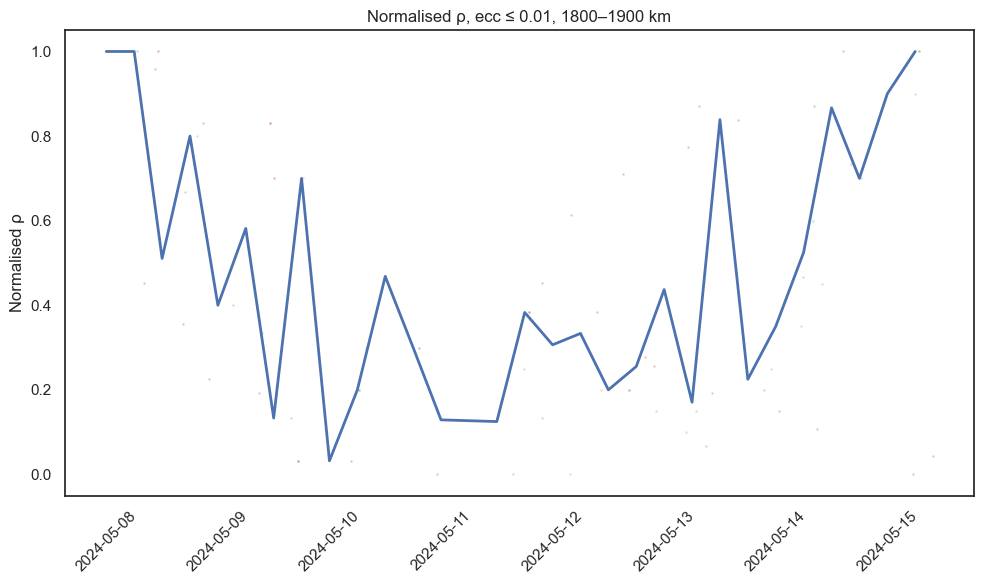

1900-2000 km band → 4 objects


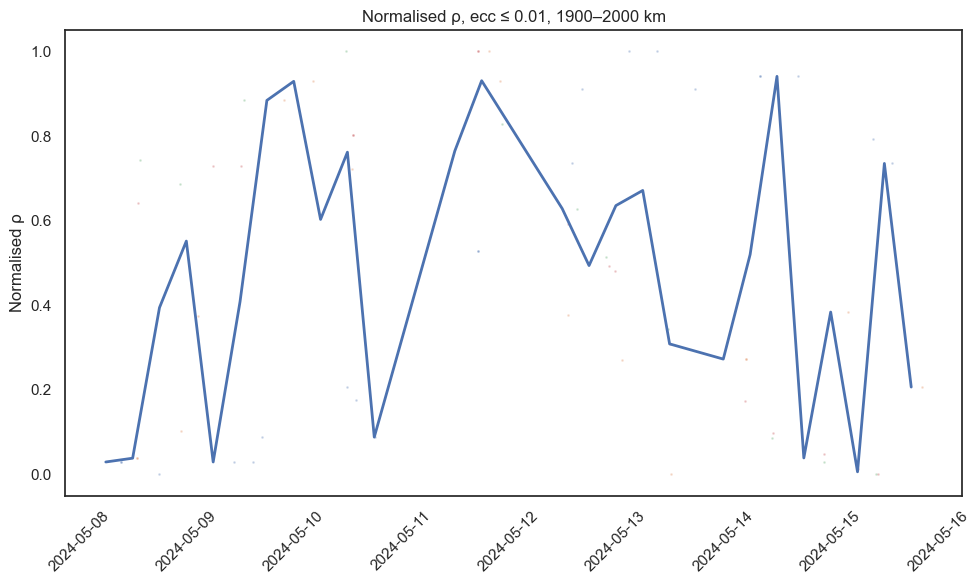

In [62]:
from collections import defaultdict
from datetime import datetime
import numpy as np
import matplotlib.pyplot as plt

# Earth radius in km (WGS-84)
R_EARTH = 6378.137

# Eccentricity filter already applied → ecc_filtered
# Compute a representative mean altitude for each satellite
sat_alt = {
    sat: (sum(r[3] for r in recs) / len(recs)) - R_EARTH
    for sat, recs in filtered_tle_dict.items()
}

bands = [(300, 400), (400, 500), (500, 600), (600, 700), (700, 800), (800,900), (900, 1000), (1000, 1100), (1100, 1200), (1200, 1300), (1300, 1400), (1400, 1500), (1500, 1600), (1600, 1700), (1700, 1800), (1800, 1900), (1900, 2000)]
bin_seconds = 21600  # 6 h bins for the moving median

for low, high in bands:
    # First 500 sats in the altitude band
    sats = [s for s, alt in sat_alt.items() if low <= alt < high][:500]
    print(f"{low}-{high} km band → {len(sats)} objects")

    all_t, all_v = [], []
    plt.figure(figsize=(10, 6))

    for sat in sats:
        recs = sorted(filtered_tle_dict[sat], key=lambda r: r[0])
        if not recs:
            continue
        t     = [r[0] for r in recs]
        rho   = [r[6] for r in recs]
        rmin, rmax = min(rho), max(rho)
        norm  = [(r - rmin) / (rmax - rmin) if rmax > rmin else 0 for r in rho]

        plt.scatter(t, norm, marker=".", s=4, alpha=0.2)
        all_t.extend(t)
        all_v.extend(norm)

    # 12-hour moving median across *all* points in the band
    bins = defaultdict(list)
    for t, v in zip(all_t, all_v):
        key = int(t.timestamp() // bin_seconds) * bin_seconds
        bins[key].append(v)

    med_t = sorted(bins)
    med_v = [np.median(bins[k]) for k in med_t]

    plt.plot(
        [datetime.utcfromtimestamp(k) for k in med_t],
        med_v,
        linewidth=2,
        label="12 h median",
    )

    plt.xticks(rotation=45)
    plt.ylabel("Normalised ρ")
    plt.title(f"Normalised ρ, ecc ≤ 0.01, {low}–{high} km")
    plt.tight_layout()
    plt.show()

300-400 km band → 195 objects
400-500 km band → 1049 objects
500-600 km band → 1180 objects
600-700 km band → 1213 objects
700-800 km band → 2113 objects
800-900 km band → 2146 objects
900-1000 km band → 1147 objects
1000-1100 km band → 378 objects
1100-1200 km band → 212 objects
1200-1300 km band → 178 objects
1300-1400 km band → 126 objects
1400-1500 km band → 952 objects
1500-1600 km band → 273 objects


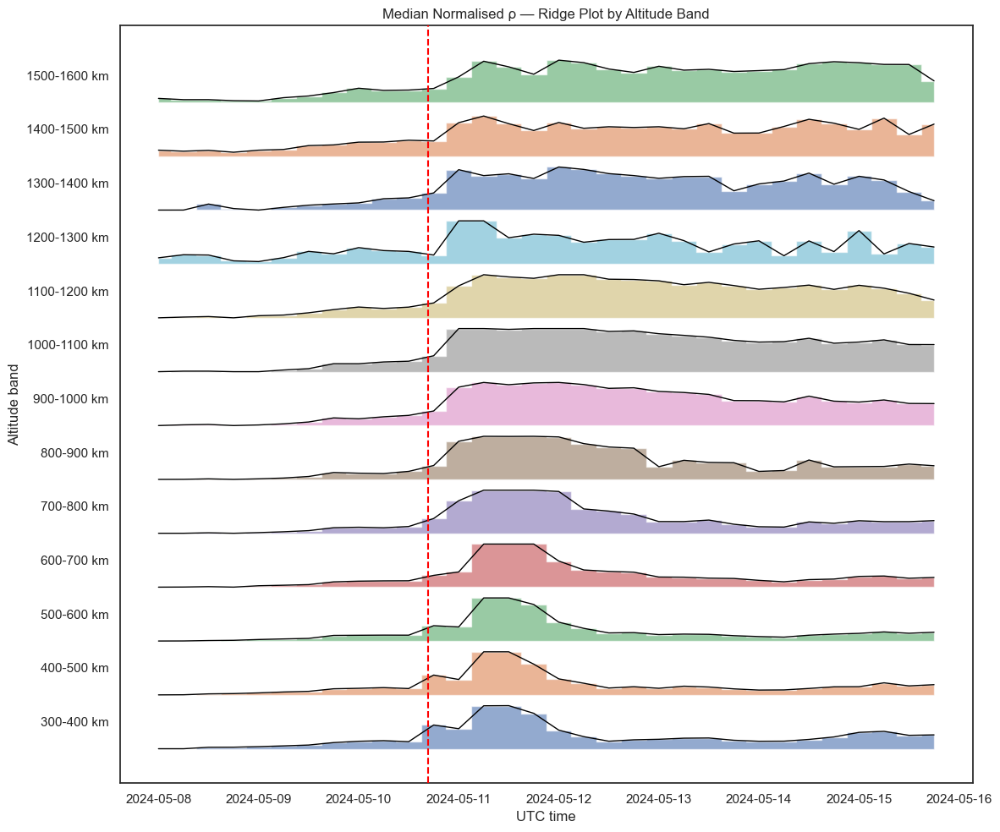

In [76]:
from collections import defaultdict
from datetime import datetime
import numpy as np
import matplotlib.pyplot as plt

R_EARTH = 6378.137  # km
# mean-altitude per satellite (ecc ≤ 0.01 already applied → ecc_filtered)
sat_alt = {
    sat: (sum(r[3] for r in recs) / len(recs)) - R_EARTH
    for sat, recs in filtered_tle_dict.items()
}

bands = [
    (300, 400), (400, 500), (500, 600), (600, 700), (700, 800),
    (800, 900), (900, 1000), (1000, 1100), (1100, 1200), (1200, 1300),
    (1300, 1400), (1400, 1500), (1500, 1600)
]

bin_sec      = 21_600      # 6-hour bins for medians
ridge_offset = 1.25        # vertical spacing between ridges

fig, ax = plt.subplots(figsize=(12, 10))
yticks, ylabels = [], []

for idx, (low, high) in enumerate(bands):
    # First 500 sats in the altitude band
    sats = [s for s, alt in sat_alt.items() if low <= alt < high]
    print(f"{low}-{high} km band → {len(sats)} objects")

    # Gather normalised ρ points for the band
    all_t, all_v = [], []
    for sat in sats:
        recs = sorted(filtered_tle_dict[sat], key=lambda r: r[0])
        if not recs:
            continue
        rho  = [r[6] for r in recs]
        rmin, rmax = min(rho), max(rho)
        norm = [(r - rmin) / (rmax - rmin) if rmax > rmin else 0 for r in rho]
        all_t.extend(r[0] for r in recs)
        all_v.extend(norm)

    if not all_t:
        continue  # nothing in this band

    # 6-hour moving median
    bins = defaultdict(list)
    for t, v in zip(all_t, all_v):
        key = int(t.timestamp() // bin_sec) * bin_sec
        bins[key].append(v)

    med_t = sorted(bins)
    med_v = [np.median(bins[k]) for k in med_t]

    # Ridge line – offset vertically
    y_base = idx * ridge_offset
    dt     = [datetime.utcfromtimestamp(k) for k in med_t]
    y      = np.array(med_v) + y_base

    ax.fill_between(dt, y_base, y, alpha=0.6, step="mid")
    ax.plot(dt, y, color="black", linewidth=1)

    yticks.append(y_base + ridge_offset / 2)
    ylabels.append(f"{low}-{high} km")
ax.axvline(
    datetime(2024, 5, 10, 16, 45),  # timestamp
    color="red",
    linestyle="--",
    linewidth=1.5,
    zorder=10                      # keeps the line on top
)
ax.set_yticks(yticks)
ax.set_yticklabels(ylabels)
ax.set_xlabel("UTC time")
ax.set_ylabel("Altitude band")
ax.set_title("Median Normalised ρ — Ridge Plot by Altitude Band")
plt.tight_layout()
plt.show()

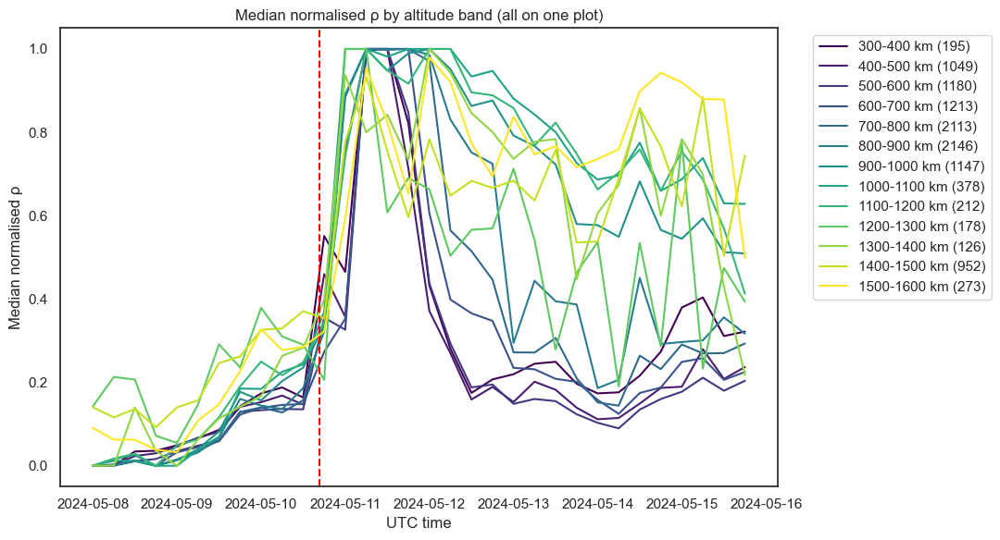

In [64]:
# Overlay every altitude-band median line in a single plot
from collections import defaultdict
from datetime import datetime
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm

R_EARTH = 6378.137
sat_alt = {sat: (sum(r[3] for r in recs) / len(recs)) - R_EARTH
           for sat, recs in filtered_tle_dict.items()}

bands = [(300, 400), (400, 500), (500, 600), (600, 700), (700, 800),
         (800, 900), (900, 1000), (1000, 1100), (1100, 1200), (1200, 1300),
         (1300, 1400), (1400, 1500), (1500, 1600)]

bin_sec = 21_600         # 6-h bins
cmap    = cm.viridis(np.linspace(0, 1, len(bands)))

plt.figure(figsize=(11, 6))

for idx, (low, high) in enumerate(bands):
    sats = [s for s, alt in sat_alt.items() if low <= alt < high]
    if not sats:
        continue

    all_t, all_v = [], []
    for s in sats:
        recs = sorted(filtered_tle_dict[s], key=lambda r: r[0])
        if not recs:
            continue
        rho  = [r[6] for r in recs]
        rmin, rmax = min(rho), max(rho)
        norm = [(r - rmin) / (rmax - rmin) if rmax > rmin else 0 for r in rho]
        all_t.extend(r[0] for r in recs)
        all_v.extend(norm)

    # 6-hour moving median for this band
    bins = defaultdict(list)
    for t, v in zip(all_t, all_v):
        bins[int(t.timestamp() // bin_sec) * bin_sec].append(v)

    if not bins:
        continue

    med_t = sorted(bins)
    med_v = [np.median(bins[k]) for k in med_t]

    plt.plot([datetime.utcfromtimestamp(k) for k in med_t],
             med_v,
             color=cmap[idx],
             linewidth=1.5,
             label=f"{low}-{high} km ({len(sats)})")

# vertical reference line
plt.axvline(datetime(2024, 5, 10, 16, 45), color="red", linestyle="--", lw=1.5)

plt.xlabel("UTC time")
plt.ylabel("Median normalised ρ")
plt.title("Median normalised ρ by altitude band (all on one plot)")
plt.legend(bbox_to_anchor=(1.04, 1), loc="upper left")
plt.tight_layout()
plt.show()

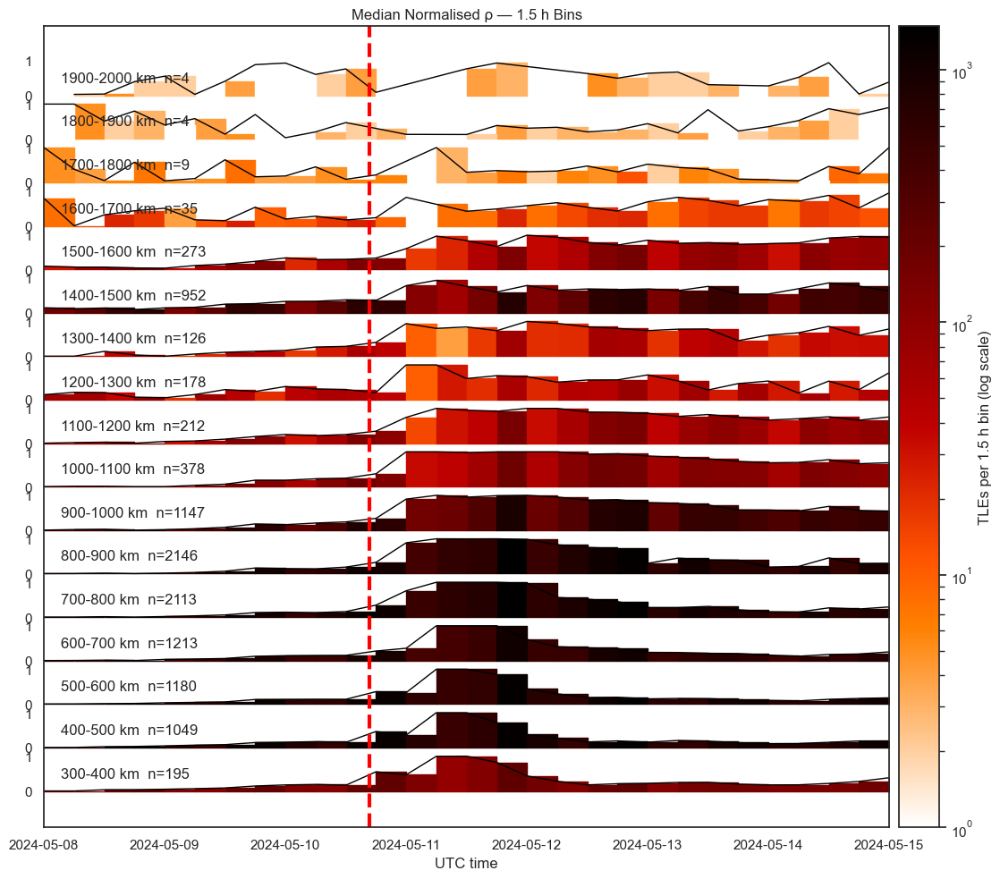

In [75]:
from collections import defaultdict
from datetime import datetime, timedelta
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import LogNorm

R_EARTH = 6378.137
sat_alt = {s: (sum(r[3] for r in recs) / len(recs)) - R_EARTH for s, recs in filtered_tle_dict.items()}

bands = [
    (300, 400), (400, 500), (500, 600), (600, 700), (700, 800),
    (800, 900), (900, 1000), (1000, 1100), (1100, 1200), (1200, 1300),
    (1300, 1400), (1400, 1500), (1500, 1600), (1600, 1700), (1700, 1800), (1800, 1900), (1900, 2000)
]

bin_sec = 21600
ridge_offset = 1.25
bin_info, all_counts = [], []

for low, high in bands:
    sats = [s for s, alt in sat_alt.items() if low <= alt < high]
    n_sats = len(sats)
    all_t, all_v = [], []
    for s in sats:
        recs = sorted(filtered_tle_dict[s], key=lambda r: r[0])
        if not recs:
            continue
        rho = [r[6] for r in recs]
        rmin, rmax = min(rho), max(rho)
        norm = [(x - rmin) / (rmax - rmin) if rmax > rmin else 0 for x in rho]
        all_t.extend(r[0] for r in recs)
        all_v.extend(norm)
    buckets = defaultdict(list)
    for t, v in zip(all_t, all_v):
        buckets[int(t.timestamp() // bin_sec) * bin_sec].append(v)
    counts = {k: len(vs) for k, vs in buckets.items()}
    med = [(k, np.median(vs)) for k, vs in buckets.items()]
    bin_info.append((low, high, counts, med, n_sats))
    all_counts.extend(counts.values())

cmap = cm.gist_heat_r
norm = LogNorm(vmin=min(all_counts), vmax=max(all_counts))

fig, ax = plt.subplots(figsize=(12, 10))
ax.set_xlim(datetime(2024, 5, 8), datetime(2024, 5, 15))
x0, x1 = ax.get_xlim()
label_x = x0 + (x1 - x0) * 0.02

for idx, (low, high, counts, med, n) in enumerate(bin_info):
    y0 = idx * ridge_offset
    for t_key, median in med:
        t0 = datetime.utcfromtimestamp(t_key)
        t1 = t0 + timedelta(seconds=bin_sec)
        colour = cmap(norm(counts[t_key]))
        ax.fill_between([t0, t1], y0, y0 + median, step="post", color=colour)
    ax.plot(
        [datetime.utcfromtimestamp(t) for t, _ in sorted(med)],
        [y0 + m for _, m in sorted(med)],
        color="black",
        linewidth=1,
    )
    ax.text(label_x, y0 + ridge_offset * 0.4, f"{low}-{high} km  n={n}", va="center")

ax.axvline(datetime(2024, 5, 10, 16, 45), color="red", linestyle="--", linewidth=3)

ticks, labels = [], []
for idx in range(len(bin_info)):
    base = idx * ridge_offset
    ticks += [base, base + 1]
    labels += ["0", "1"]
ax.set_yticks(ticks)
ax.set_yticklabels(labels)

ax.set_xlabel("UTC time")
ax.set_title("Median Normalised ρ — 1.5 h Bins")

cbar = fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax, pad=0.01)
cbar.set_label("TLEs per 1.5 h bin (log scale)")

plt.tight_layout()
plt.show()

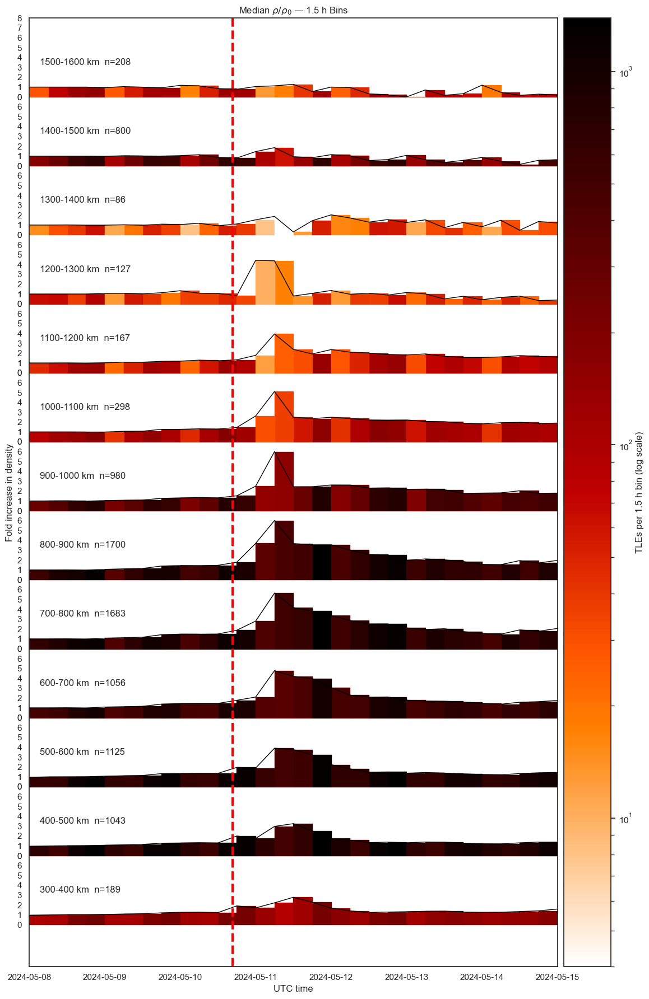

In [74]:
from collections import defaultdict
from datetime import datetime, timedelta, timezone
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import LogNorm

R_EARTH = 6378.137
sat_alt = {s: (sum(r[3] for r in recs) / len(recs)) - R_EARTH for s, recs in filtered_tle_dict.items()}

bands = [
    (300, 400), (400, 500), (500, 600), (600, 700), (700, 800),
    (800, 900), (900, 1000), (1000, 1100), (1100, 1200), (1200, 1300),
    (1300, 1400), (1400, 1500), (1500, 1600)
]

bin_sec = 21600 
ridge_offset = 7
rho0_start = datetime(2024, 5, 8, tzinfo=timezone.utc)
rho0_end = rho0_start + timedelta(days=1)

bin_info, all_counts = [], []

for low, high in bands:
    sats = [s for s, alt in sat_alt.items() if low <= alt < high]
    active = set()
    all_t, all_v = [], []
    for s in sats:
        recs = sorted(filtered_tle_dict[s], key=lambda r: r[0])
        if not recs:
            continue
        rho0_vals = [r[6] for r in recs if rho0_start <= r[0] < rho0_end]
        if not rho0_vals:
            continue
        rho0 = float(np.mean(rho0_vals))
        if rho0 == 0:
            continue
        active.add(s)
        all_t.extend(r[0] for r in recs)
        all_v.extend([r[6] / rho0 for r in recs])
    if not all_t:
        continue
    buckets = defaultdict(list)
    for t, v in zip(all_t, all_v):
        buckets[int(t.timestamp() // bin_sec) * bin_sec].append(v)
    counts = {k: len(vs) for k, vs in buckets.items()}
    if not counts:
        continue
    med = [(k, np.median(vs)) for k, vs in buckets.items()]
    bin_info.append((low, high, counts, med, len(active)))
    all_counts.extend(counts.values())

vmin = min(c for c in all_counts if c > 0)
vmax = max(all_counts)
cmap = cm.gist_heat_r
norm = LogNorm(vmin=vmin, vmax=vmax)

fig, ax = plt.subplots(figsize=(12, 18))
ax.set_xlim(datetime(2024, 5, 8, tzinfo=timezone.utc), datetime(2024, 5, 15, tzinfo=timezone.utc))
x0, x1 = ax.get_xlim()
label_x = x0 + (x1 - x0) * 0.02

for idx, (low, high, counts, med, n) in enumerate(bin_info):
    y0 = idx * ridge_offset
    for t_key, median in med:
        t0 = datetime.fromtimestamp(t_key, tz=timezone.utc)
        t1 = t0 + timedelta(seconds=bin_sec)
        colour = cmap(norm(counts[t_key]))
        ax.fill_between([t0, t1], y0, y0 + median, step="post", color=colour)
    ax.plot(
        [datetime.fromtimestamp(t, tz=timezone.utc) for t, _ in sorted(med)],
        [y0 + m for _, m in sorted(med)],
        color="black",
        linewidth=1,
    )
    ax.text(label_x, y0 + ridge_offset * 0.5, f"{low}-{high} km  n={n}", va="center")

ax.axvline(datetime(2024, 5, 10, 16, 45, tzinfo=timezone.utc), color="red", linestyle="--", linewidth=3)

ticks, labels = [], []
for idx in range(len(bin_info)):
    base = idx * ridge_offset
    for val in range(9):
        ticks.append(base + val)
        labels.append(str(val))
ax.set_yticks(ticks)
ax.set_yticklabels(labels)
ax.set_ylabel("Fold increase in density")

ax.set_xlabel("UTC time")
ax.set_title(r"Median $\rho/\rho_0$ — 1.5 h Bins")

cbar = fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax, pad=0.01)
cbar.set_label("TLEs per 1.5 h bin (log scale)")

plt.tight_layout()
plt.show()

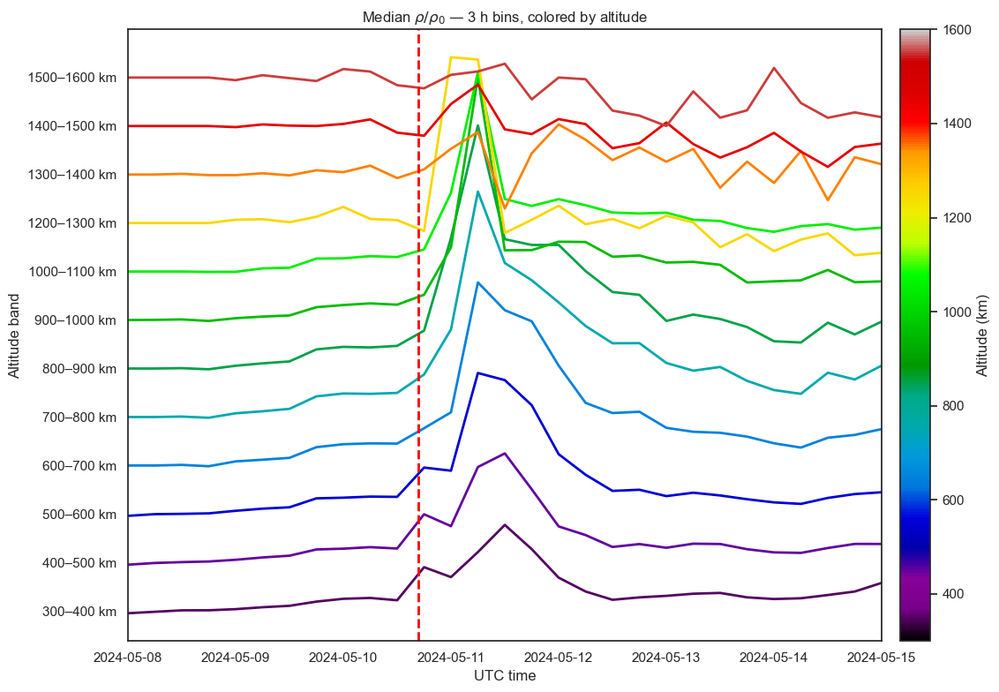

In [73]:
from collections import defaultdict
from datetime import datetime, timedelta, timezone
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import Normalize

# --- assume filtered_tle_dict is already defined ---

R_EARTH = 6378.137
# compute each satellite’s mean altitude above Earth surface (km)
sat_alt = {
    s: (sum(r[3] for r in recs) / len(recs)) - R_EARTH
    for s, recs in filtered_tle_dict.items()
}

# altitude bands (km)
bands = [
    (300, 400), (400, 500), (500, 600),
    (600, 700), (700, 800), (800, 900),
    (900, 1000), (1000, 1100), (1200, 1300),
    (1300, 1400), (1400, 1500), (1500, 1600)
]

bin_sec = 21600       # 3-hour bins
ridge_offset = 1.0        # vertical spacing
rho0_start = datetime(2024, 5, 8, tzinfo=timezone.utc)
rho0_end   = rho0_start + timedelta(days=1)

# colormap for altitude midpoint
alt_min, alt_max = bands[0][0], bands[-1][1]
norm = Normalize(vmin=alt_min, vmax=alt_max)
cmap = cm.nipy_spectral

# collect median time-series per band
bin_info = []
for low, high in bands:
    sats = [s for s, alt in sat_alt.items() if low <= alt < high]
    all_t, all_v = [], []
    for s in sats:
        recs = sorted(filtered_tle_dict[s], key=lambda r: r[0])
        rho0_vals = [r[6] for r in recs if rho0_start <= r[0] < rho0_end]
        if not rho0_vals:
            continue
        rho0 = float(np.mean(rho0_vals))
        if rho0 == 0:
            continue
        all_t.extend(r[0] for r in recs)
        all_v.extend(r[6] / rho0 for r in recs)
    if not all_t:
        continue

    buckets = defaultdict(list)
    for t, v in zip(all_t, all_v):
        key = int(t.timestamp() // bin_sec) * bin_sec
        buckets[key].append(v)

    med = sorted((k, np.median(vs)) for k, vs in buckets.items())
    if med:
        bin_info.append((low, high, med))

# plot
fig, ax = plt.subplots(figsize=(12, 8))
ax.set_xlim(rho0_start, rho0_start + timedelta(days=7))

yticks, ylabels = [], []
for i, (low, high, med) in enumerate(bin_info):
    y0 = i * ridge_offset
    # tick at midpoint of ridge
    yticks.append(y0 + ridge_offset * 1)
    ylabels.append(f"{low}–{high} km")

    times = [datetime.fromtimestamp(k, tz=timezone.utc) for k, _ in med]
    vals  = [y0 + m for _, m in med]
    mid_alt = 0.5 * (low + high)
    color = cmap(norm(mid_alt))
    ax.plot(times, vals, color=color, linewidth=2)

ax.axvline(datetime(2024, 5, 10, 16, 45, tzinfo=timezone.utc),
           color='red', linestyle='--', linewidth=2)

ax.set_yticks(yticks)
ax.set_yticklabels(ylabels)
ax.set_ylabel("Altitude band")

ax.set_xlabel("UTC time")
ax.set_title(r"Median $\rho/\rho_0$ — 3 h bins, colored by altitude")

# colorbar
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])
cbar = fig.colorbar(sm, ax=ax, pad=0.02)
cbar.set_label("Altitude (km)")

plt.tight_layout()
plt.show()

/Users/charlesc/anaconda3/envs/erp_tools_env/lib/python3.11/site-packages/seaborn/_base.py:948: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/charlesc/anaconda3/envs/erp_tools_env/lib/python3.11/site-packages/seaborn/_base.py:948: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/charlesc/anaconda3/envs/erp_tools_env/lib/python3.11/site-packages/seaborn/_base.py:948: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/charlesc/anaconda3/envs/erp_tools_env/lib/python3.11/site-packages/seaborn/_base.py:948: FutureWarning:

Whe

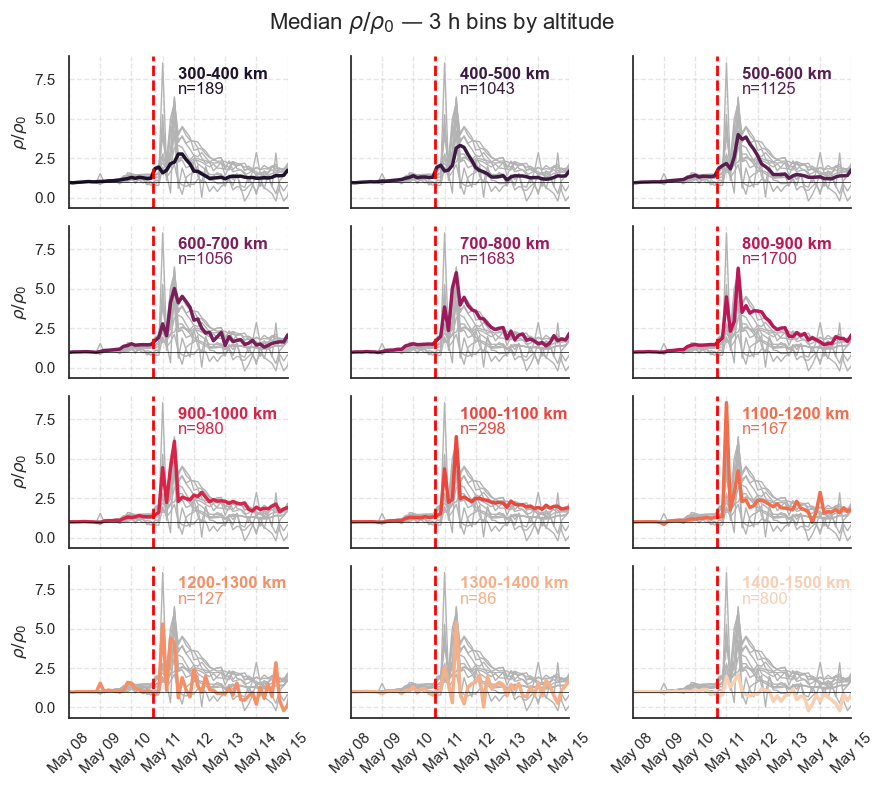

In [77]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from collections import defaultdict
from datetime import datetime, timedelta, timezone
import numpy as np

# --- recompute bin_info with counts ---
R_EARTH = 6378.137
sat_alt = {
    s: (sum(r[3] for r in recs) / len(recs)) - R_EARTH
    for s, recs in filtered_tle_dict.items()
}
bands = [
    (300,400),(400,500),(500,600),
    (600,700),(700,800),(800,900),
    (900,1000),(1000,1100),(1100,1200),(1200,1300),
    (1300,1400),(1400,1500)#,(1500,1600)
]
bin_sec = 21600/2
rho0_start = datetime(2024,5,8,tzinfo=timezone.utc)
rho0_end   = rho0_start + timedelta(days=1)

bin_info = []
for low, high in bands:
    sats = [s for s,alt in sat_alt.items() if low<=alt<high]
    all_t, all_v = [], []
    active = 0
    for s in sats:
        recs = sorted(filtered_tle_dict[s], key=lambda r: r[0])
        rho0_vals = [r[6] for r in recs if rho0_start<=r[0]<rho0_end]
        if not rho0_vals: continue
        rho0 = float(np.mean(rho0_vals))
        if rho0==0: continue
        active += 1
        all_t.extend(r[0] for r in recs)
        all_v.extend(max(r[6]/rho0, -0.2) for r in recs)  # force min threshold
    if not all_t: continue
    buckets = defaultdict(list)
    for t,v in zip(all_t, all_v):
        key = int(t.timestamp()//bin_sec)*bin_sec
        buckets[key].append(v)
    med = sorted((k, np.median(vs)) for k,vs in buckets.items())
    if med:
        bin_info.append((low, high, med, active))

# flatten to DataFrame
records = []
for low, high, med, active in bin_info:
    band = f"{low}-{high}"
    for t_key, m in med:
        records.append({
            "time": datetime.fromtimestamp(t_key, tz=timezone.utc),
            "median": m,
            "band": band
        })
df = pd.DataFrame(records)

sns.set_theme(style="white")
palette = sns.color_palette("rocket", n_colors=len(bin_info))
band_order = [f"{low}-{high}" for low,high,_,_ in bin_info]
n_map = {f"{low}-{high}": active for low,high,_,active in bin_info}

col_wrap = 3
g = sns.relplot(
    data=df, x="time", y="median",
    col="band", hue="band",
    kind="line", palette=palette,
    hue_order=band_order, col_order=band_order,
    estimator=None, units="band",
    linewidth=1, alpha=0.3,
    legend=False, col_wrap=col_wrap,
    height=2, aspect=1.5
)
g.fig.subplots_adjust(hspace=0.2, top=0.92)

axes = g.axes.flatten()
n_axes = len(axes)
n_cols = col_wrap
n_rows = (n_axes + n_cols - 1) // n_cols

for i, band in enumerate(band_order):
    ax = axes[i]
    sns.lineplot(
        data=df, x="time", y="median",
        units="band", estimator=None,
        color=".7", linewidth=1, ax=ax
    )
    color = palette[i]
    sns.lineplot(
        data=df[df["band"]==band],
        x="time", y="median",
        estimator=None,
        color=color, linewidth=2.5, ax=ax
    )
    ax.text(.5, .85, f"{band} km",
            transform=ax.transAxes, fontweight="bold", color=color)
    ax.text(.5, .75, f"n={n_map[band]}",
            transform=ax.transAxes, color=color)

    ax.axvline(datetime(2024,5,10,16,45,tzinfo=timezone.utc),
               color="red", linestyle="--", linewidth=2)

    row = i // n_cols
    if row == n_rows - 1:
        ax.xaxis.set_major_locator(mdates.DayLocator())
        ax.xaxis.set_major_formatter(mdates.DateFormatter("%b %d"))
        ax.set_xlabel("Date")
        ax.tick_params(axis="x", rotation=45)
    else:
        ax.set_xlabel("")
        ax.set_xticklabels([])

    ax.set_ylabel("")
    ax.set_xlim(datetime(2024,5,8,tzinfo=timezone.utc),
                datetime(2024,5,15,tzinfo=timezone.utc))
    ax.axhline(1, color='black', linewidth=0.5, linestyle='-')

g.set_titles("")  
g.set_axis_labels("", r"$\rho/\rho_0$")
g.fig.suptitle("Median $\u03C1/\\rho_0$ — 3 h bins by altitude", fontsize=16)
#add grid lines
for ax in g.axes.flatten():
    ax.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.savefig("rho_median_by_band.png", dpi=400)
plt.show()

/var/folders/nh/9y501_nj2x56h2t3ch9_05f40000gn/T/ipykernel_32924/1163335671.py:40: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



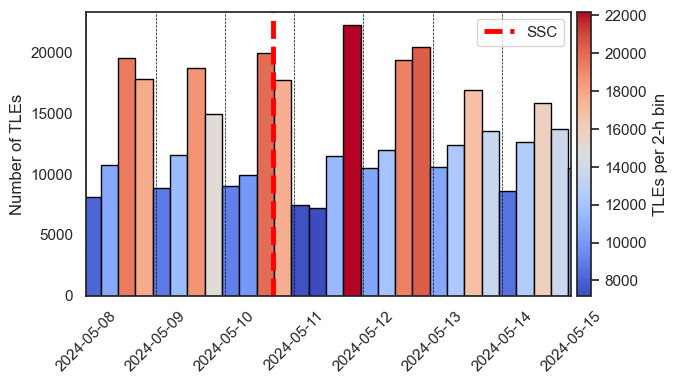

In [72]:
from datetime import datetime, timedelta
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import Normalize

# ---- parameters ----
BIN_SEC   = 21_600              
SHIFT_SEC = 0              # shift bins so they start at XX:45
BAR_WIDTH = BIN_SEC / 86_400     # width in days for matplotlib
start_dt  = datetime(2024, 5,  8)        # first day
end_dt    = datetime(2024, 5, 15, 0, 1)  # last bin must start before this

# ---- collect all TLE times (as timestamps) ----
# adjust each record by SHIFT_SEC so histogram bins fall at XX:45
all_ts = []
for recs in all_tle_dict.values():
    for rec in recs:
        t = rec[0].timestamp()
        all_ts.append(t + SHIFT_SEC)

all_ts = np.array(all_ts)

# ---- define bin edges shifted by SHIFT_SEC ----
start_edge = start_dt.timestamp() + SHIFT_SEC
end_edge   = end_dt.timestamp()   + SHIFT_SEC + BIN_SEC
edges = np.arange(start_edge, end_edge, BIN_SEC)

# ---- histogram counts ----
counts, _ = np.histogram(all_ts, bins=edges)

# ---- bin start times back to datetime ----
bin_starts = edges[:-1] - SHIFT_SEC
bin_datetimes = [datetime.utcfromtimestamp(ts) for ts in bin_starts]

# ---- colour by count ----
norm = Normalize(vmin=counts.min(), vmax=counts.max())
# cmap = cm.nipy_spectral
#use seaborn's color palette icefire
cmap = cm.get_cmap("coolwarm", lut=None)
bar_colors = cmap(norm(counts))

# ---- plot ----
fig, ax = plt.subplots(figsize=(7, 4))
ax.bar(bin_datetimes, counts,
       width=BAR_WIDTH, align='edge',
       color=bar_colors, edgecolor="black")

# vertical line at SSC
ax.axvline(datetime(2024, 5, 10, 16, 45),
           color='red', linestyle='--', linewidth=3.5, label='SSC')

ax.set_xlim(start_dt, datetime(2024, 5, 15, 0, 1))
ax.set_ylabel("Number of TLEs")

plt.xticks(rotation=45)

#add little lines that correspnd to the x and y ticks
xticks = ax.get_xticks()
for xt in xticks:
    ax.axvline(xt, color='black', linestyle='--', linewidth=0.5)

# colourbar for counts
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array(counts)
cbar = fig.colorbar(sm, ax=ax, pad=0.01)
cbar.set_label("TLEs per 2-h bin")

ax.legend(loc='upper right')
plt.tight_layout()
plt.savefig("tle_histogram_300-1600km.png", dpi=300)
plt.show()

In [12]:
import pandas as pd
import plotly.graph_objects as go

# file paths
file_paths = {
    "Sentinel-2A": (
        "/Users/charlesc/Documents/GitHub/POD-Density-Inversion/"
        "output/PODDensityInversion/Data/Sentinel-2A/"
        "Sentinel-2A_2024-05-07_density_inversion.csv"
    ),
    "Sentinel-1A": (
        "/Users/charlesc/Documents/GitHub/POD-Density-Inversion/"
        "output/PODDensityInversion/Data/Sentinel-1A/"
        "Sentinel-1A_2024-05-07_density_inversion.csv"
    ),
    "GRACE-FO-A": (
        "/Users/charlesc/Documents/GitHub/POD-Density-Inversion/"
        "output/PODDensityInversion/Data/GRACE-FO-A/"
        "GRACE-FO-A_2024-05-07_density_inversion.csv"
    ),
}

# load data and compute 180-point rolling average
dfs = {}
for sat, path in file_paths.items():
    df = pd.read_csv(path)
    df["UTC"] = pd.to_datetime(df["UTC"], utc=True)
    df.set_index("UTC", inplace=True)
    df["rolling180"] = df["Computed Density"].rolling(window=180).mean()
    dfs[sat] = df

# colors for each satellite
color_map = {
    "Sentinel-2A": "blue",
    "Sentinel-1A": "green",
    "GRACE-FO-A":  "red",
}

# build figure
fig = go.Figure()
for sat, df in dfs.items():
    fig.add_trace(go.Scatter(
        x=df.index,
        y=df["Computed Density"],
        mode="lines",
        name=f"{sat} – raw",
        line=dict(color=color_map[sat], dash="solid")
    ))
    fig.add_trace(go.Scatter(
        x=df.index,
        y=df["rolling180"],
        mode="lines",
        name=f"{sat} – 180-pt rolling",
        line=dict(color=color_map[sat], dash="solid")
    ))

fig.update_layout(
    title="Satellite Computed Density & 180-Point Rolling Average",
    xaxis_title="Time (UTC)",
    yaxis_title="Density (kg/m³)",
    legend_title="Series",
    xaxis=dict(showgrid=True),
    yaxis=dict(showgrid=True),
)

fig.show()

In [134]:
import pandas as pd
import plotly.graph_objects as go

# time window
start_dt = pd.Timestamp('2024-05-08T00:00Z')
end_dt   = pd.Timestamp('2024-05-15T00:00Z')

# file paths
file_paths = {
    "Sentinel-2A": (
        "/Users/charlesc/Documents/GitHub/POD-Density-Inversion/"
        "output/PODDensityInversion/Data/Sentinel-2A/"
        "Sentinel-2A_2024-05-07_density_inversion.csv"
    ),
    "Sentinel-1A": (
        "/Users/charlesc/Documents/GitHub/POD-Density-Inversion/"
        "output/PODDensityInversion/Data/Sentinel-1A/"
        "Sentinel-1A_2024-05-07_density_inversion.csv"
    ),
    "GRACE-FO-A": (
        "/Users/charlesc/Documents/GitHub/POD-Density-Inversion/"
        "output/PODDensityInversion/Data/GRACE-FO-A/"
        "GRACE-FO-A_2024-05-07_density_inversion.csv"
    ),
}

# load, slice, compute rolling & normalize
dfs = {}
for sat, path in file_paths.items():
    df = pd.read_csv(path)
    df["UTC"] = pd.to_datetime(df["UTC"], utc=True)
    df.set_index("UTC", inplace=True)

    # restrict to 8–15 May
    df = df.loc[start_dt:end_dt]

    # 180-point rolling mean (allowing partial)
    df["rolling180"] = df["Computed Density"].rolling(window=180, min_periods=1).mean()

    # baseline rho0 from the first 360 points in this window
    rho0 = df["rolling180"].iloc[:5000].mean()
    df["ratio"] = df["rolling180"] / rho0

    dfs[sat] = df

# plot normalized curves
fig = go.Figure()
for sat, df in dfs.items():
    fig.add_trace(go.Scatter(
        x=df.index,
        y=df["ratio"],
        mode="lines",
        name=sat
    ))

fig.update_layout(
    title="Normalized Density (ρ/ρ₀) – 180-Point Rolling Avg (8–15 May 2024)",
    xaxis_title="Time (UTC)",
    yaxis_title="ρ / ρ₀",
    legend_title="Satellite",
    xaxis=dict(showgrid=True),
    yaxis=dict(showgrid=True),
)

fig.show()

In [136]:
import pandas as pd
import plotly.graph_objects as go

# time window
start_dt = pd.Timestamp('2024-05-08T00:00Z')
end_dt   = pd.Timestamp('2024-05-15T00:00Z')

# file paths
file_paths = {
    "Sentinel-2A": (
        "/Users/charlesc/Documents/GitHub/POD-Density-Inversion/"
        "output/PODDensityInversion/Data/Sentinel-2A/"
        "Sentinel-2A_2024-05-07_density_inversion.csv"
    ),
    "Sentinel-1A": (
        "/Users/charlesc/Documents/GitHub/POD-Density-Inversion/"
        "output/PODDensityInversion/Data/Sentinel-1A/"
        "Sentinel-1A_2024-05-07_density_inversion.csv"
    ),
    "GRACE-FO-A": (
        "/Users/charlesc/Documents/GitHub/POD-Density-Inversion/"
        "output/PODDensityInversion/Data/GRACE-FO-A/"
        "GRACE-FO-A_2024-05-07_density_inversion.csv"
    ),
}

# orbit sample windows (samples per orbit at 30 s cadence)
orbit_windows = {
    "Sentinel-2A": 201,
    "Sentinel-1A": 197,
    "GRACE-FO-A":  188,
}

# load, slice, compute orbit-mean & normalize
dfs = {}
for sat, path in file_paths.items():
    df = pd.read_csv(path)
    df["UTC"] = pd.to_datetime(df["UTC"], utc=True)
    df.set_index("UTC", inplace=True)

    # restrict to 8–15 May
    df = df.loc[start_dt:end_dt]

    # one-orbit rolling mean (window = orbit_windows[sat])
    w = orbit_windows[sat]
    df["orbit_mean"] = df["Computed Density"].rolling(window=w, min_periods=1).mean()

    # baseline ρ₀ from first 360 orbit means
    rho0 = df["orbit_mean"].iloc[:3000].median()
    df["ratio"] = df["orbit_mean"] / rho0

    dfs[sat] = df

# plot normalized orbit-averaged density
fig = go.Figure()
for sat, df in dfs.items():
    fig.add_trace(go.Scatter(
        x=df.index,
        y=df["ratio"],
        mode="lines",
        name=sat
    ))

fig.update_layout(
    title="Normalized Density (ρ/ρ₀) – One-Orbit Rolling Avg (8–15 May 2024)",
    xaxis_title="Time (UTC)",
    yaxis_title="ρ / ρ₀",
    legend_title="Satellite",
    xaxis=dict(showgrid=True),
    yaxis=dict(showgrid=True),
)

fig.show()

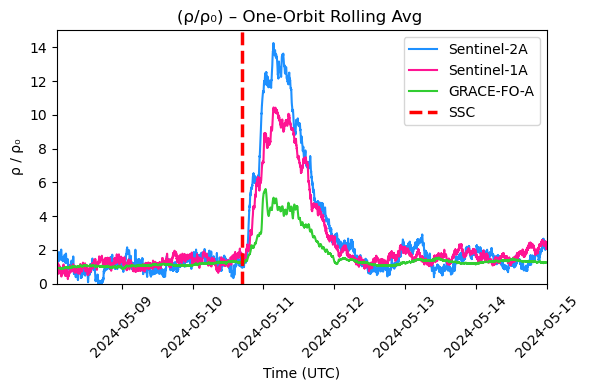

In [174]:
import pandas as pd
import matplotlib.pyplot as plt

start_dt = pd.Timestamp('2024-05-08T00:00Z')
end_dt   = pd.Timestamp('2024-05-15T00:00Z')

file_paths = {
    "Sentinel-2A": "/Users/charlesc/Documents/GitHub/POD-Density-Inversion/output/PODDensityInversion/Data/Sentinel-2A/Sentinel-2A_2024-05-07_density_inversion.csv",
    "Sentinel-1A": "/Users/charlesc/Documents/GitHub/POD-Density-Inversion/output/PODDensityInversion/Data/Sentinel-1A/Sentinel-1A_2024-05-07_density_inversion.csv",
    "GRACE-FO-A": "/Users/charlesc/Documents/GitHub/POD-Density-Inversion/output/PODDensityInversion/Data/GRACE-FO-A/GRACE-FO-A_2024-05-07_density_inversion.csv",
}

orbit_windows = {
    "Sentinel-2A": 201,
    "Sentinel-1A": 197,
    "GRACE-FO-A": 188,
}

dfs = {}
for sat, path in file_paths.items():
    df = pd.read_csv(path)
    df["UTC"] = pd.to_datetime(df["UTC"], utc=True)
    df.set_index("UTC", inplace=True)
    df = df.loc[start_dt:end_dt]
    w = orbit_windows[sat]
    df["orbit_mean"] = df["Computed Density"].rolling(window=w, min_periods=1).mean()
    rho0 = df["orbit_mean"].iloc[:3000].median()
    df["ratio"] = df["orbit_mean"] / rho0
    dfs[sat] = df

order = ["Sentinel-2A", "Sentinel-1A", "GRACE-FO-A"]
colors = {"Sentinel-2A": "#1E90FF", "Sentinel-1A": "#FF1493", "GRACE-FO-A": "#32CD32"}
fig, ax = plt.subplots(figsize=(6, 4))
for sat in order:
    ax.plot(dfs[sat].index, dfs[sat]["ratio"], label=sat, color=colors[sat])

ax.set_xlim(pd.Timestamp('2024-05-08T02:00Z'), pd.Timestamp('2024-05-15T00:00Z'))
#rotate x ticks by 45 degrees
plt.xticks(rotation=45)
ax.set_ylim(0, 15)
#add vertical line at 2024-05-10T16:45Z
ax.axvline(pd.Timestamp('2024-05-10T16:45Z'), color='red', linestyle='--', linewidth=2.5, label='SSC')
ax.set_xlabel("Time (UTC)")
ax.set_ylabel("ρ / ρ₀")
ax.set_title("(ρ/ρ₀) – One-Orbit Rolling Avg ")
ax.legend()
plt.tight_layout()
plt.show()